###Tomamos datos de la web, de un sitio web

In [34]:
import os

from groq import Groq
from langchain_groq import ChatGroq
from langchain_community.document_loaders import WebBaseLoader
from langchain_community.document_loaders import RecursiveUrlLoader
#from langchain_community.embeddings import OllamaEmbeddings
from langchain.embeddings import HuggingFaceEmbeddings
from langchain_community.vectorstores import FAISS
from sentence_transformers import SentenceTransformer
import faiss
from langchain.text_splitter import RecursiveCharacterTextSplitter
from langchain.chains.combine_documents import create_stuff_documents_chain
from langchain_core.prompts import ChatPromptTemplate
from langchain.chains import create_retrieval_chain
from langchain_core.output_parsers import StrOutputParser
from langchain_core.runnables import RunnablePassthrough
from dotenv import load_dotenv

In [3]:
load_dotenv()

True

In [4]:
groq_api_key= os.environ.get("GROQ_API_KEY")

In [5]:
page_url = "https://capacitacion.jusmisiones.gov.ar/"

In [6]:
loader = RecursiveUrlLoader(
        page_url, 
        max_depth=3,
        prevent_outside=True
        )
#loader = WebBaseLoader(web_path=[page_url])

In [7]:
docs = []
docs_lazy = loader.lazy_load()

# async variant:
# docs_lazy = await loader.alazy_load()

for doc in docs_lazy:
    docs.append(doc)
print(docs[0].page_content[:100])
print(docs[0].metadata)

C:\Users\Asus3\AppData\Local\Programs\Python\Python312\Lib\html\parser.py:171: XMLParsedAsHTMLWarning: It looks like you're parsing an XML document using an HTML parser. If this really is an HTML document (maybe it's XHTML?), you can ignore or filter this warning. If it's XML, you should know that using an XML parser will be more reliable. To parse this document as XML, make sure you have the lxml package installed, and pass the keyword argument `features="xml"` into the BeautifulSoup constructor.
  k = self.parse_starttag(i)


<!DOCTYPE html>
<html lang="es-es" dir="ltr">
<head>
    <meta charset="utf-8">
	<meta name="viewpor
{'source': 'https://capacitacion.jusmisiones.gov.ar/', 'content_type': 'text/html; charset=utf-8', 'title': 'Inicio ', 'language': 'es-es'}


In [ ]:
#docs = []
#async for doc in RecursiveUrlLoader(page_url).alazy_load():
 #   docs.append(doc)

C:\Users\Asus3\AppData\Local\Programs\Python\Python312\Lib\html\parser.py:171: XMLParsedAsHTMLWarning: It looks like you're parsing an XML document using an HTML parser. If this really is an HTML document (maybe it's XHTML?), you can ignore or filter this warning. If it's XML, you should know that using an XML parser will be more reliable. To parse this document as XML, make sure you have the lxml package installed, and pass the keyword argument `features="xml"` into the BeautifulSoup constructor.
  k = self.parse_starttag(i)


In [80]:
#docs=[]
#async for doc in loader.alazy_load():
    #docs.append(doc)

[Document(metadata={'source': 'https://capacitacion.jusmisiones.gov.ar/', 'content_type': 'text/html; charset=utf-8', 'title': 'Inicio ', 'language': 'es-es'}, page_content='<!DOCTYPE html>\n<html lang="es-es" dir="ltr">\n<head>\n    <meta charset="utf-8">\n\t<meta name="viewport" content="width=device-width, initial-scale=1">\n\t<meta name="generator" content="Joomla! - Open Source Content Management">\n\t<title>Inicio </title>\n\t<link href="/index.php?format=feed&amp;type=rss" rel="alternate" type="application/rss+xml" title="RSS 2.0">\n\t<link href="/index.php?format=feed&amp;type=atom" rel="alternate" type="application/atom+xml" title="Atom 1.0">\n\t<link href="/media/system/images/joomla-favicon.svg" rel="icon" type="image/svg+xml">\n\t<link href="/media/templates/site/cassiopeia/images/favicon.ico" rel="alternate icon" type="image/vnd.microsoft.icon">\n\t<link href="/media/system/images/joomla-favicon-pinned.svg" rel="mask-icon" color="#000">\n\n    <link href="/media/system/css
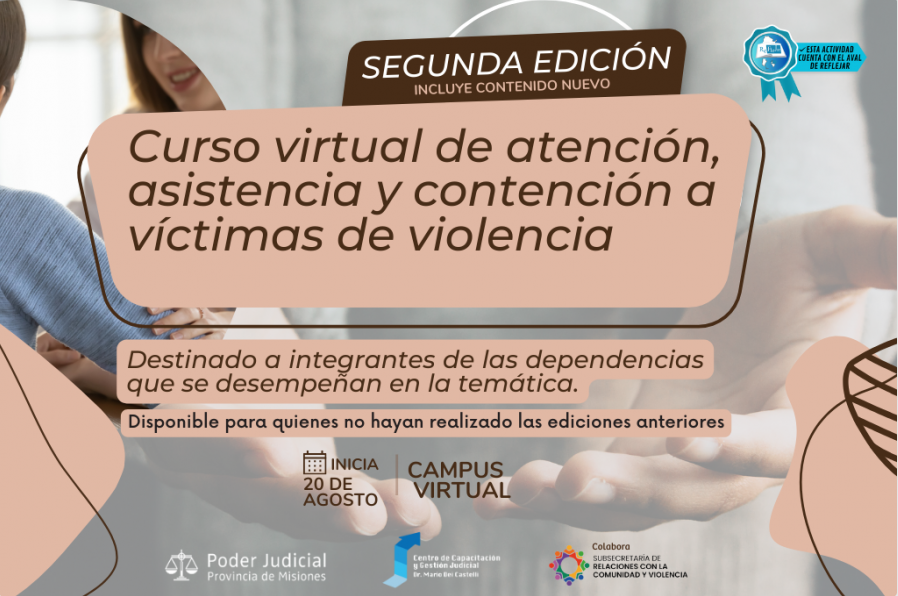
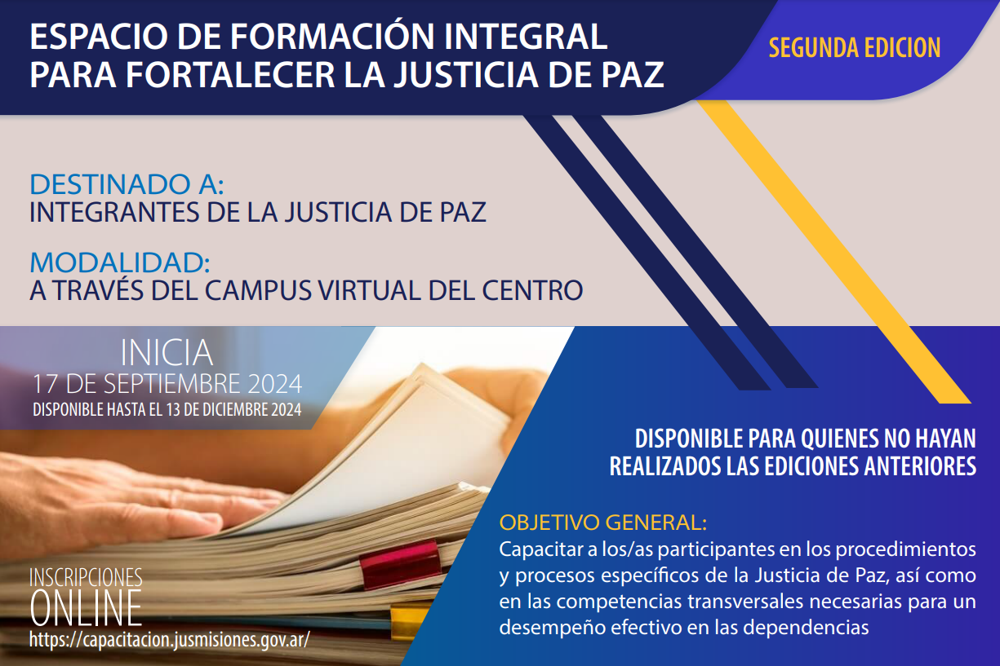
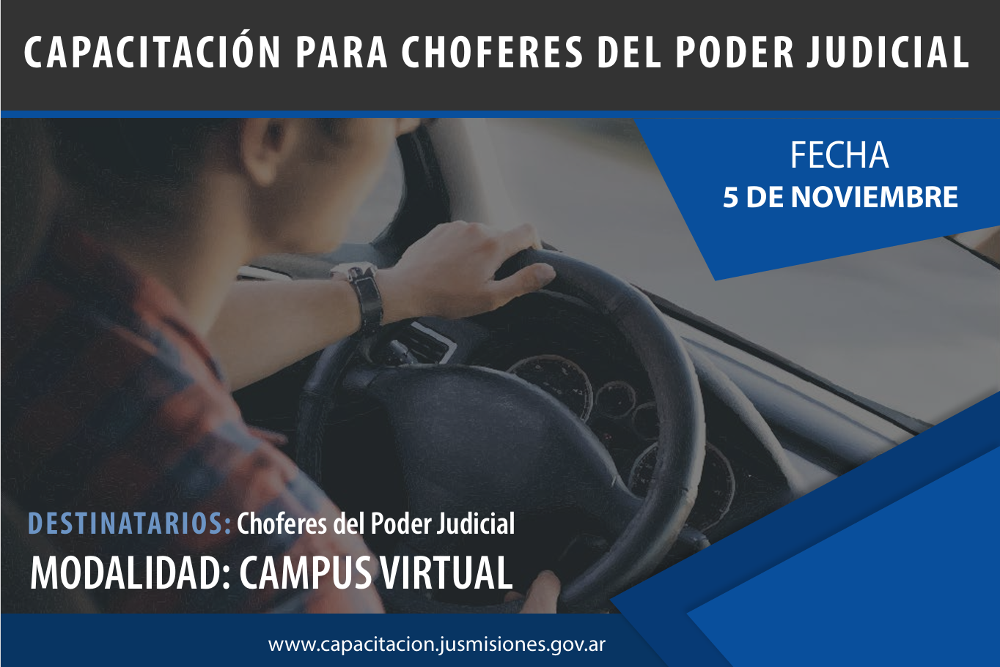
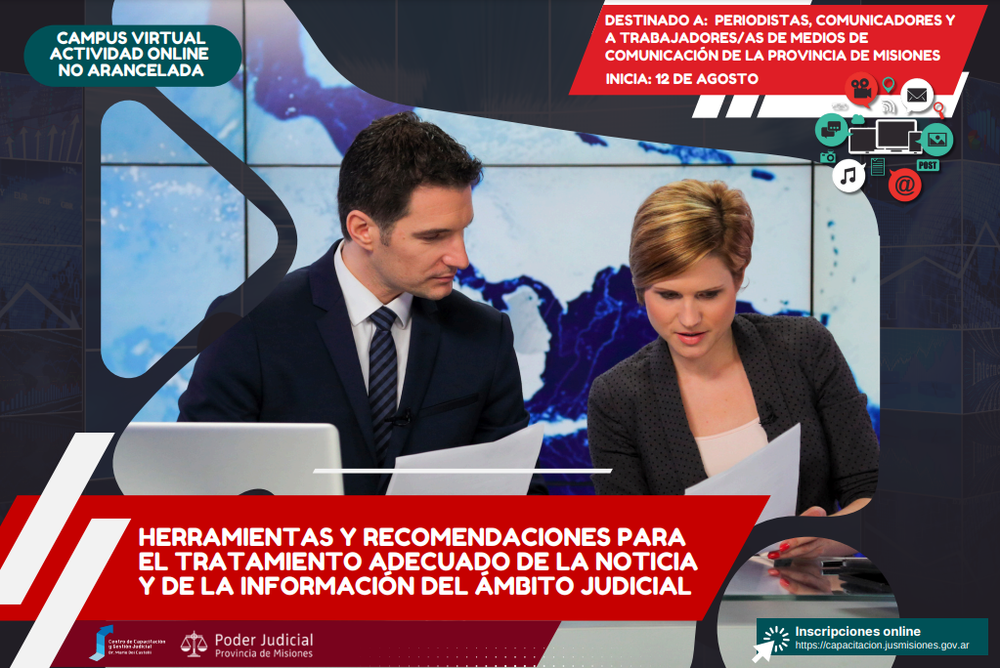
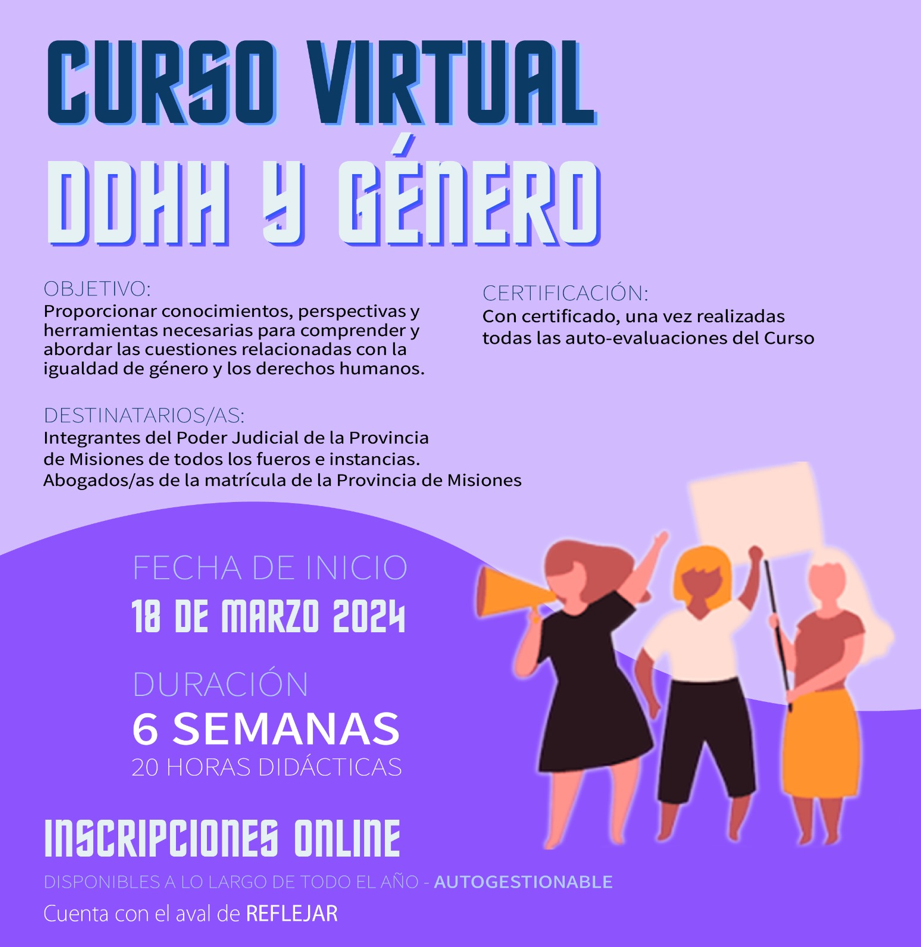
...
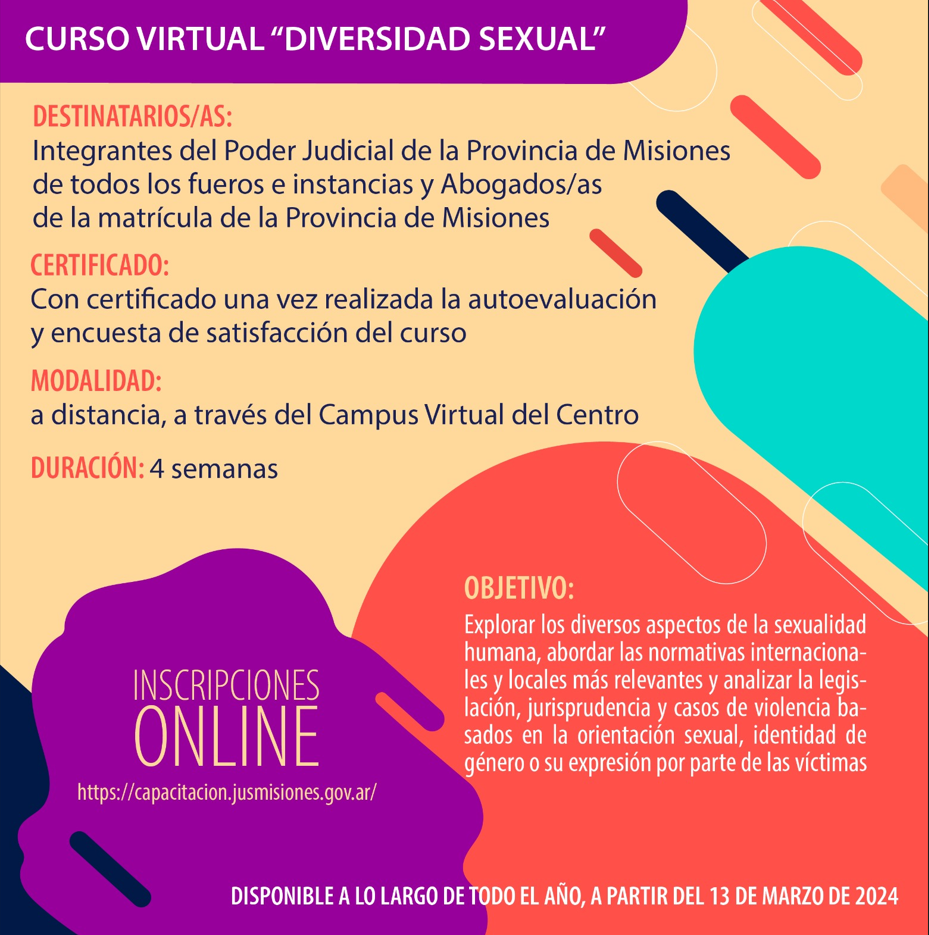
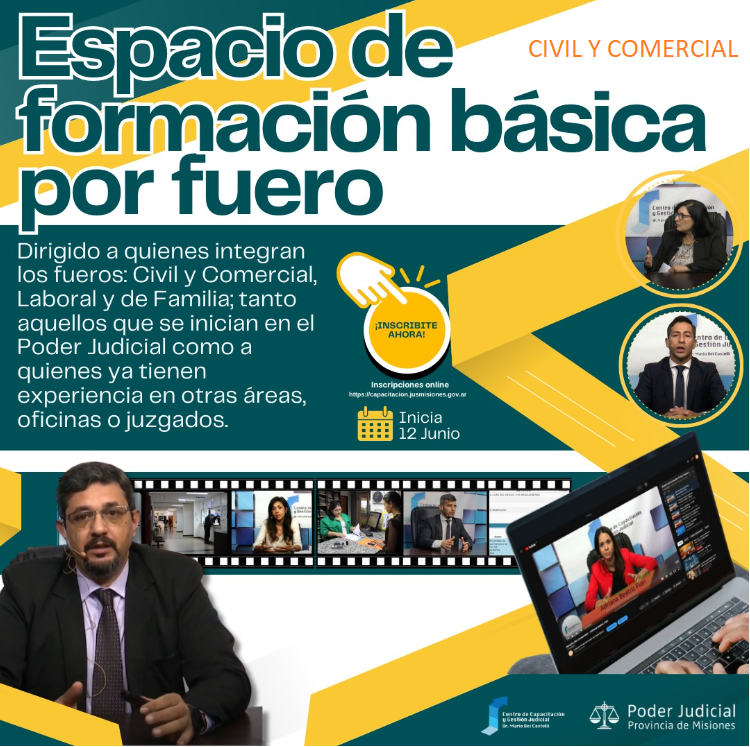
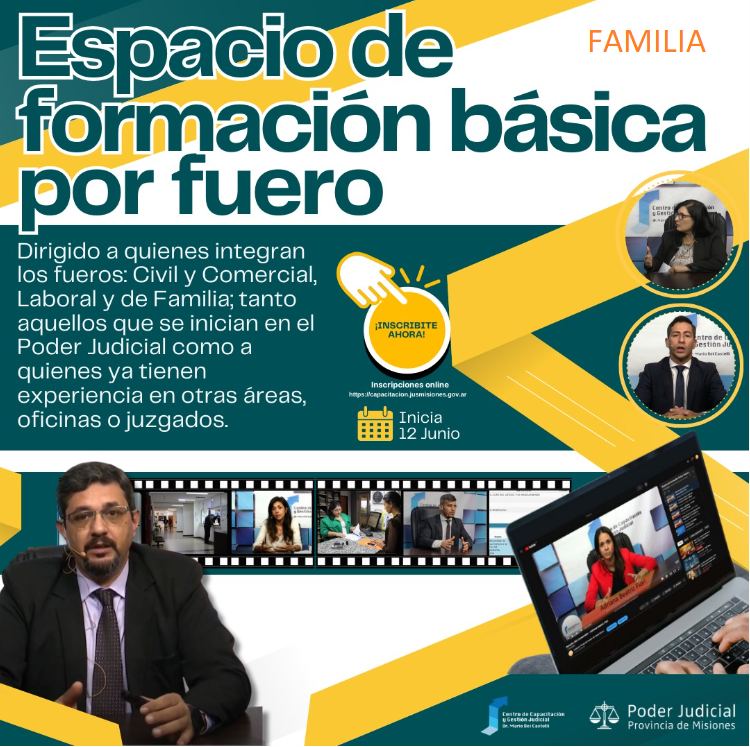
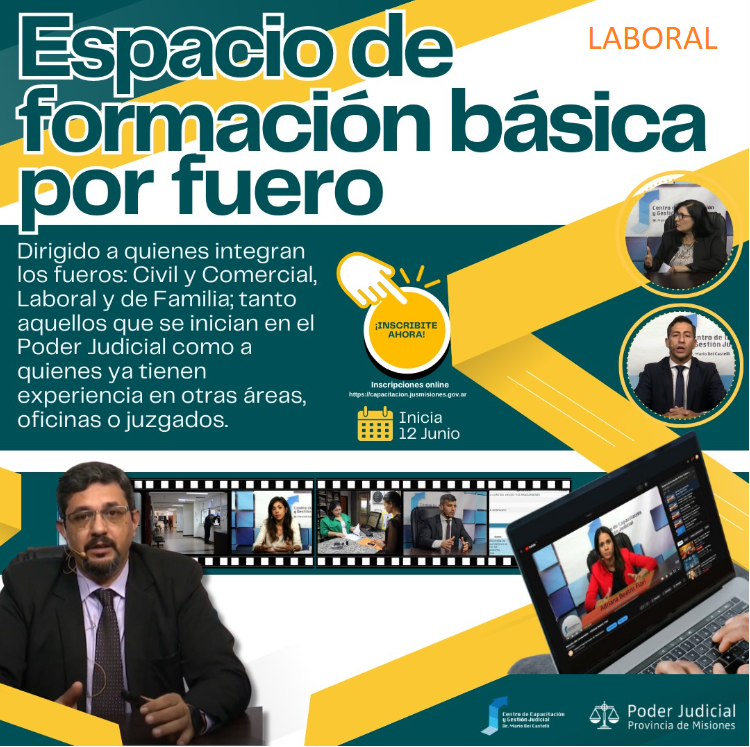
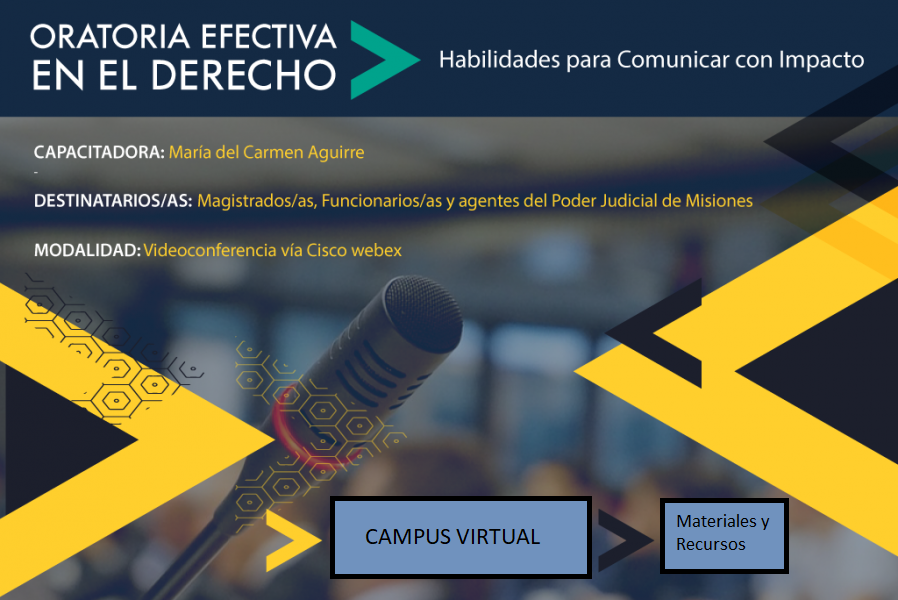

In [8]:
docs

In [8]:
text_splitter = RecursiveCharacterTextSplitter(
    chunk_size=1000,
    chunk_overlap=50,
    separators=["\n", "\n\n", "."]
)

In [9]:
documents = text_splitter.split_documents(docs)

[Document(metadata={'source': 'https://capacitacion.jusmisiones.gov.ar/', 'content_type': 'text/html; charset=utf-8', 'title': 'Inicio ', 'language': 'es-es'}, page_content='<!DOCTYPE html>\n<html lang="es-es" dir="ltr">\n<head>\n    <meta charset="utf-8">\n\t<meta name="viewport" content="width=device-width, initial-scale=1">\n\t<meta name="generator" content="Joomla! - Open Source Content Management">\n\t<title>Inicio </title>\n\t<link href="/index.php?format=feed&amp;type=rss" rel="alternate" type="application/rss+xml" title="RSS 2.0">\n\t<link href="/index.php?format=feed&amp;type=atom" rel="alternate" type="application/atom+xml" title="Atom 1.0">\n\t<link href="/media/system/images/joomla-favicon.svg" rel="icon" type="image/svg+xml">\n\t<link href="/media/templates/site/cassiopeia/images/favicon.ico" rel="alternate icon" type="image/vnd.microsoft.icon">\n\t<link href="/media/system/images/joomla-favicon-pinned.svg" rel="mask-icon" color="#000">'),
 Document(metadata={'source': 'ht
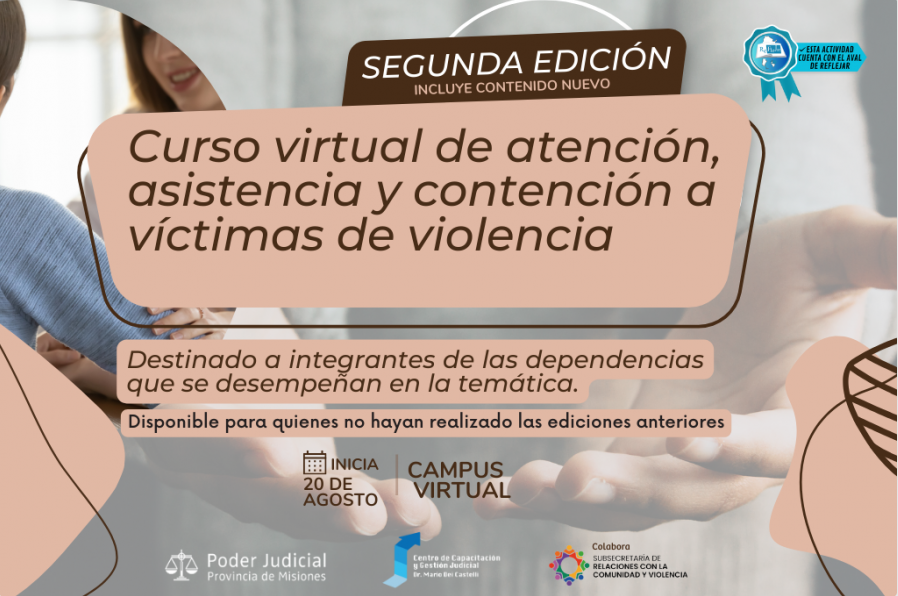
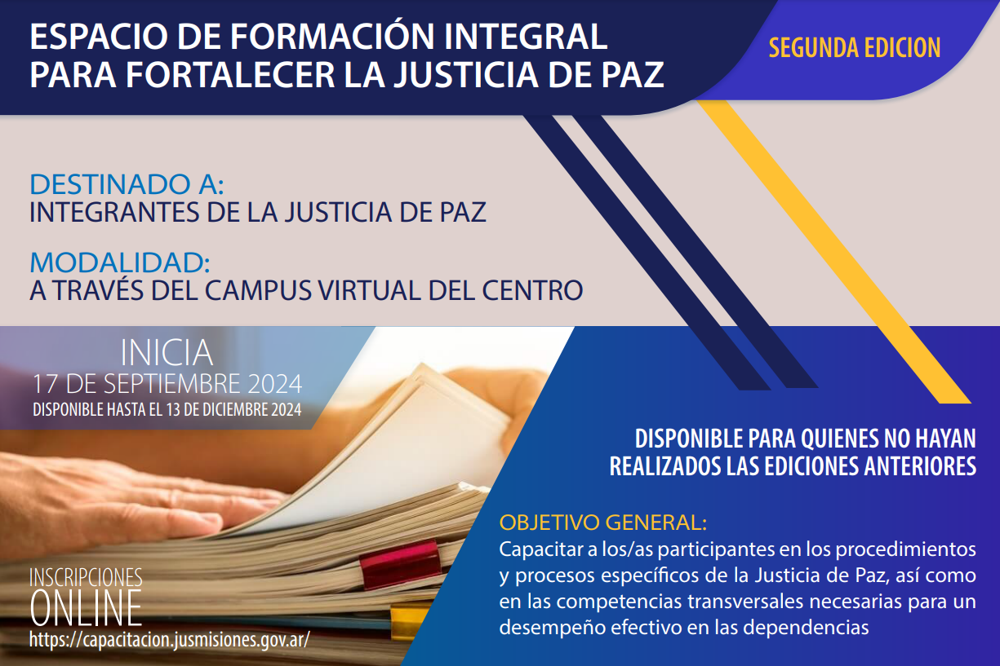
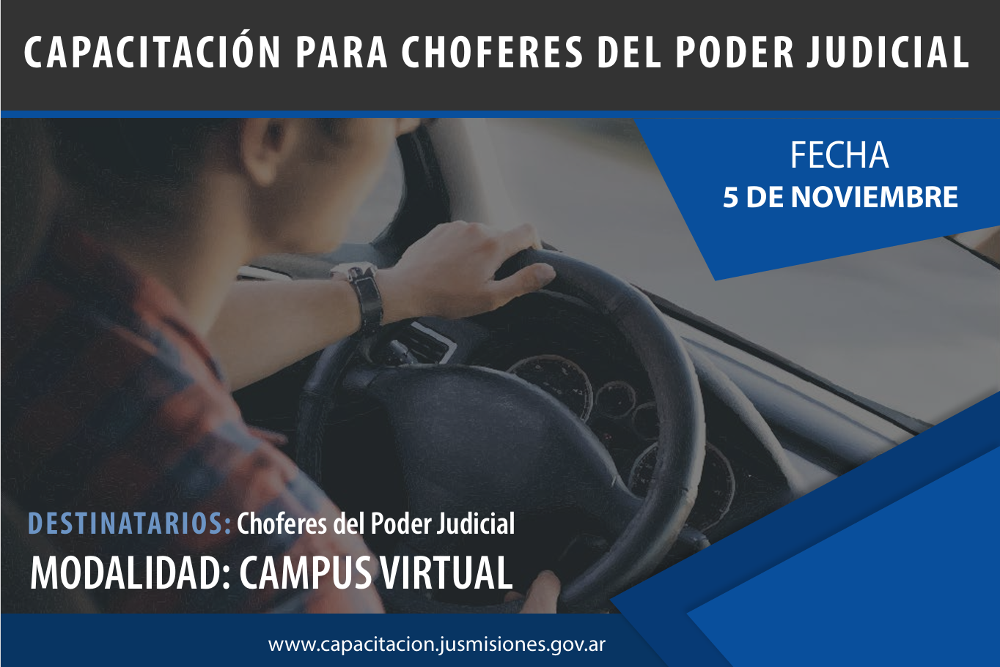
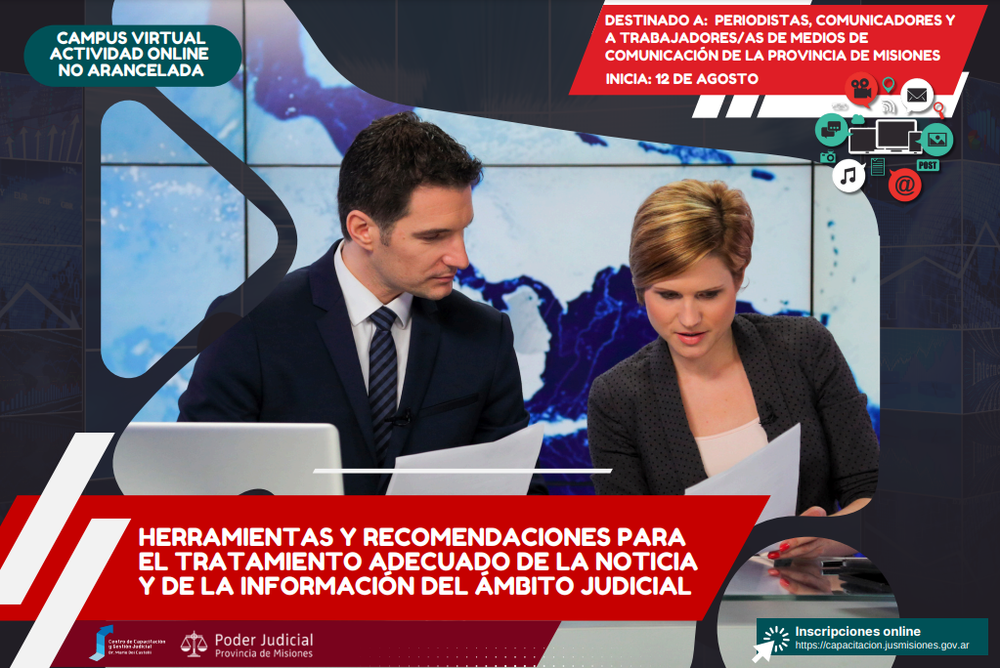
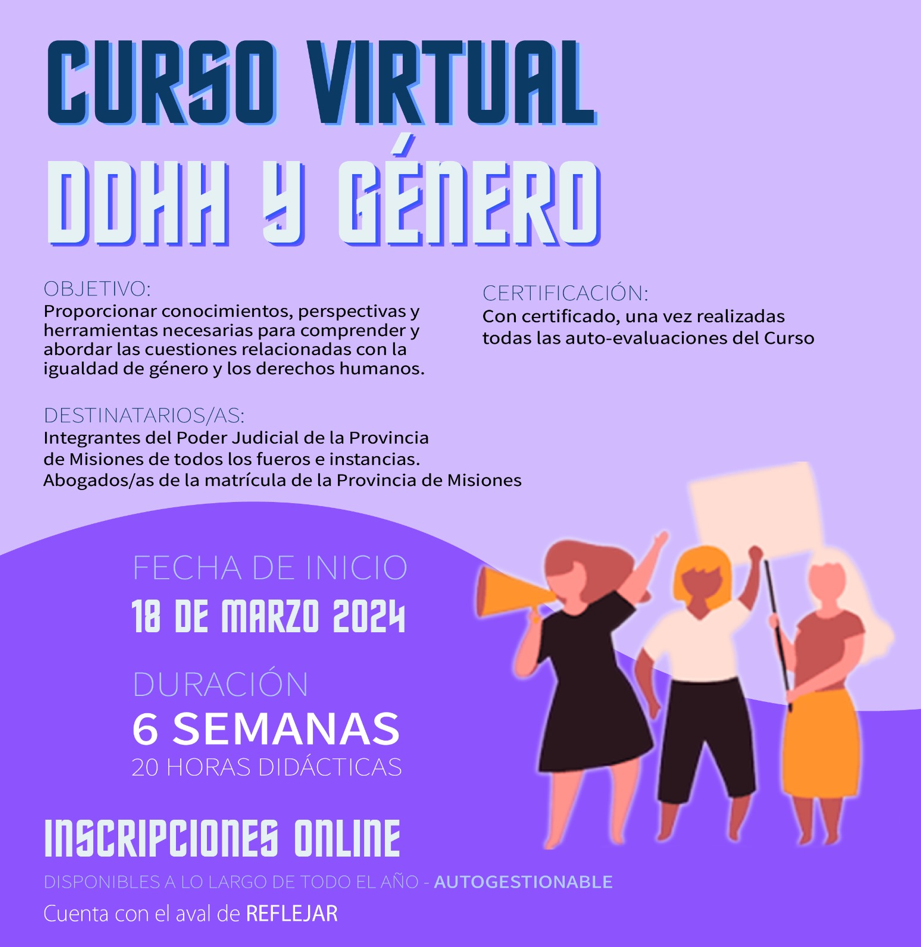
...
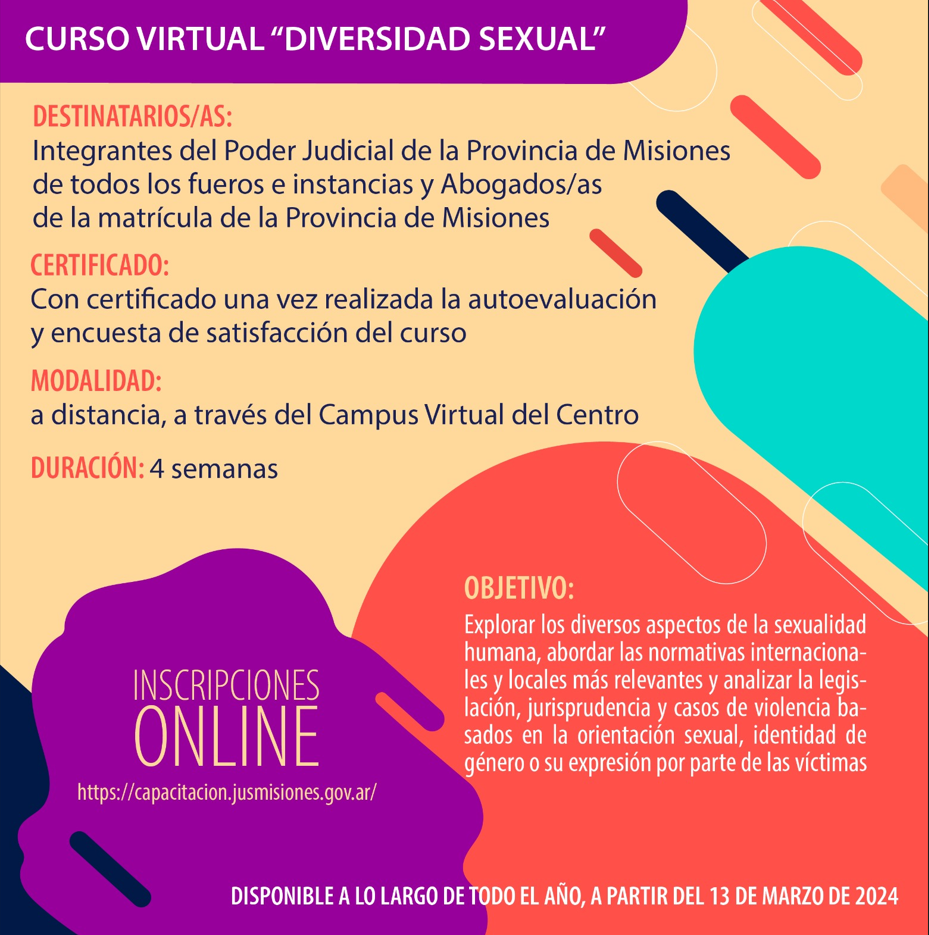
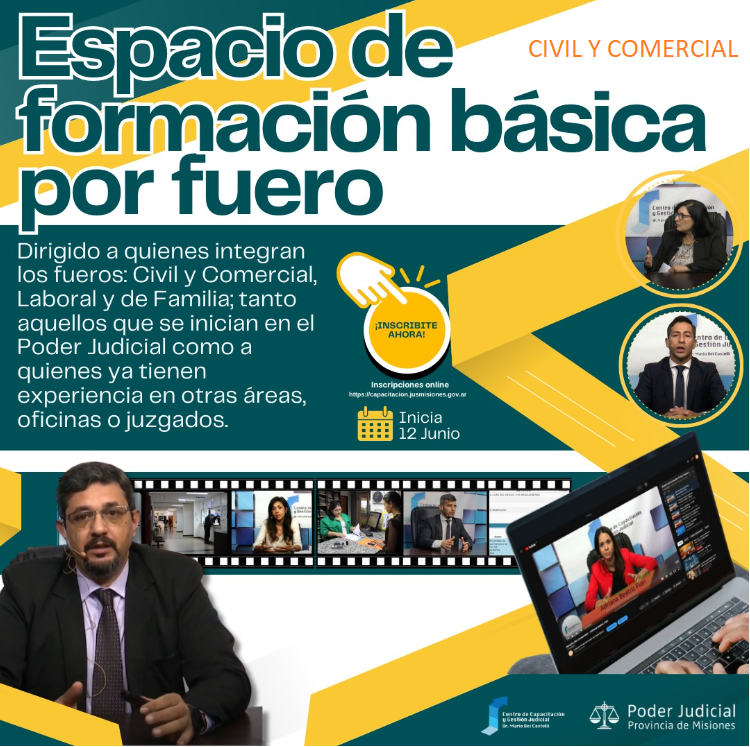
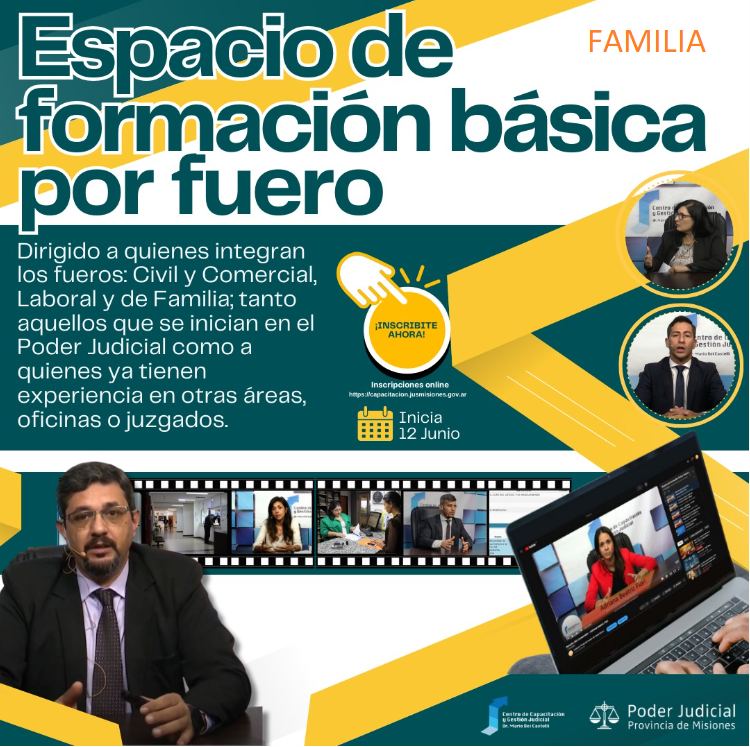
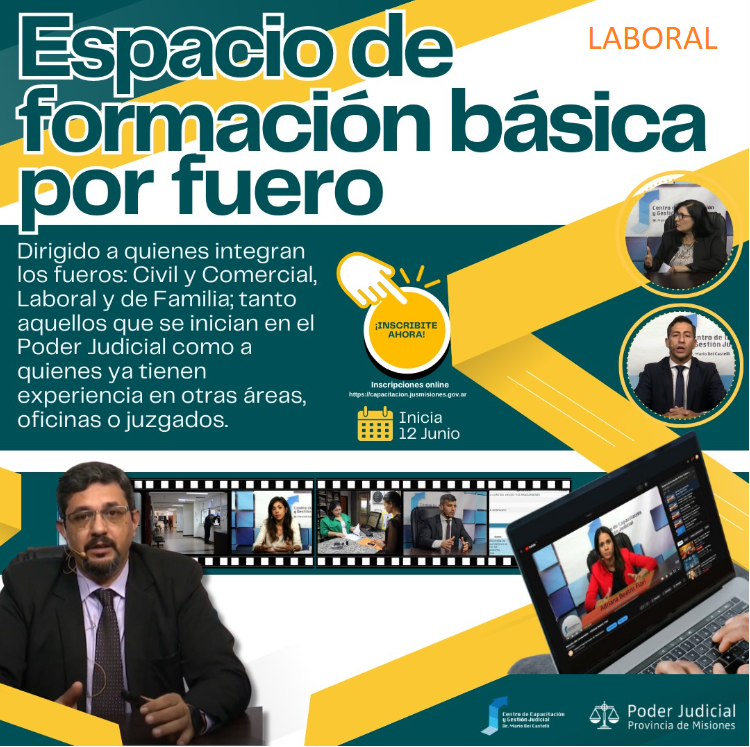
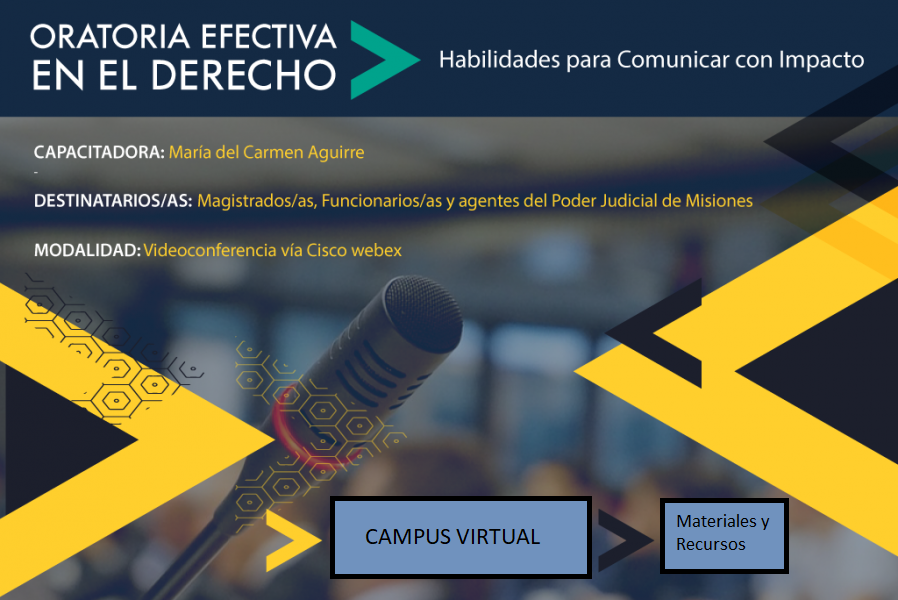

In [10]:
documents

In [11]:
documents[0].metadata
#con esto tomamos datos del sitio para alimentar la metadata

{'source': 'https://capacitacion.jusmisiones.gov.ar/',
 'content_type': 'text/html; charset=utf-8',
 'title': 'Inicio ',
 'language': 'es-es'}

In [12]:
llm = ChatGroq(
    groq_api_key=groq_api_key, 
    model_name='gemma2-9b-it',
    temperature=0
)

In [13]:
#embeddings = OllamaEmbeddings(model="llama3")
embeddings = HuggingFaceEmbeddings(model_name="sentence-transformers/all-MiniLM-L6-v2")

C:\Users\Asus3\AppData\Local\Temp\ipykernel_24352\75773110.py:2: LangChainDeprecationWarning: The class `HuggingFaceEmbeddings` was deprecated in LangChain 0.2.2 and will be removed in 1.0. An updated version of the class exists in the :class:`~langchain-huggingface package and should be used instead. To use it run `pip install -U :class:`~langchain-huggingface` and import as `from :class:`~langchain_huggingface import HuggingFaceEmbeddings``.
  embeddings = HuggingFaceEmbeddings(model_name="sentence-transformers/all-MiniLM-L6-v2")
d:\IA\proyectos\BotsIA\venv\Lib\site-packages\sentence_transformers\cross_encoder\CrossEncoder.py:13: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from tqdm.autonotebook import tqdm, trange
d:\IA\proyectos\BotsIA\venv\Lib\site-packages\transformers\tokenization_utils_base.py:1617: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` b

In [14]:
text_embeddings = embeddings.embed_documents([doc.page_content for doc in documents])

In [15]:
print(text_embeddings[:5])

[[0.005207544658333063, -0.030433859676122665, -0.0677940621972084, 0.024488693103194237, 0.10858616977930069, 0.034812141209840775, -0.09671956300735474, -0.02296072244644165, 0.05104045942425728, -0.04655429348349571, 0.0076116290874779224, 0.040983691811561584, -0.006859729532152414, 0.0037159076891839504, 0.023701054975390434, -0.019204579293727875, -0.06378918886184692, -0.050110068172216415, -0.009323722682893276, -0.08423180133104324, 0.04384903609752655, 0.0022549694404006004, 0.027607306838035583, -0.05884822458028793, 0.012256615795195103, 0.009492684155702591, -0.02207723818719387, 0.052888382226228714, -0.036858830600976944, -0.021252481266856194, 0.10639456659555435, -0.05228232964873314, 0.06175224855542183, -0.031499266624450684, 0.03694732487201691, -0.010376658290624619, 0.008929450064897537, -0.08492258936166763, 0.03857516497373581, 0.09111741930246353, 0.011054571717977524, -0.02720818668603897, 0.027159014716744423, -0.05323568359017372, -0.08061222732067108, -0.02

In [18]:
vectorstore = FAISS.from_documents(documents, embeddings)


In [ ]:
#vectorstore = FAISS.from_texts([doc.page_content for doc in documents], text_embeddings)

In [ ]:
#vectorstore = FAISS.from_documents(documents, embeddings)

In [19]:
retriever = vectorstore.as_retriever()
#similaridad x cosena

In [21]:
template = """Responder unicamente las preguntas basadas en el siguiente contexto
{context}

Pregunta: {question}
"""

In [22]:
prompt = ChatPromptTemplate.from_template(template)

In [23]:
out_parser =  StrOutputParser()

In [24]:
chain = (
    {"context": retriever, "question": RunnablePassthrough()}
    | prompt
    | llm
    | out_parser
)
"""
chain = create_stuff_documents_chain(
    llm, 
    prompt, 
    output_parser
)"""

'\nchain = create_stuff_documents_chain(\n    llm, \n    prompt, \n    output_parser\n)'

In [32]:
res = chain.invoke("me puedes dar un listado de cursos disponibles?")
print(res)

De acuerdo al texto proporcionado, los cursos disponibles son:

* **Curso Virtual Pericias Judiciales - Edición 2024**
* **Curso Introductorio a la Lengua de Señas Argentina (LSA)** 





## Notes
#### pip install streamlit
#### Set-ExecutionPolicy -ExecutionPolicy Bypass -Scope Process